# CIND 820 Project Initial Results and Code
Title: Geospatial Analysis of Collision Locations in Ottawa



---


Dataset

https://open.ottawa.ca/datasets/ottawa::traffic-collision-data/about


Table of Contents

1.   Data Import and Description
2.   Data Preprocessing
3.   Exploratory Data Analysis
4.   Feature Engineering and Algorithm Exploration
5.   K-Means Clustering Hotspot Visualization
6.   Collision Prediction using Logistic Regression
7.   Collision Prediction using Random Forest
8.   Comparison and Results
8.   Conclusion



In [1]:
%reset -f

# Section 1. Data Import and Description

---

1.   Import libraries and load the dataset
2.   Display dataset
3.   Print a summary of the data attributes
4.   Show the descriptive statistics for all columns
5.   Check for any missing values




In [2]:
# Step 1: Import Libraries and load the dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import timedelta
%matplotlib inline

pd.pandas.set_option('display.max_columns', None)
data=pd.read_csv("Traffic_Collision_Data.csv")

In [3]:
# Step 2: Display dataset

# Problematic columns:
# The column Accident_Time contains "Unknown" values
# Accident Year does not contain any data
# X, Y, GeoID, X_Cordinate, Y_Coordinate are duplicates
# ID, GEOID are metadata
# Classification_Of_Accident, etc contains numbers corresponding categorical data

data.head(10)

,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,03 - P.D. only,07 - SMV other,03 - Loose snow,02 - Rain,07 - Dark,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1
1,-8.422792e+06,5.689206e+06,2017--2,__3Z07B5,NaN,2017/01/01,3:16,VANIER PKWY SB btwn DONALD ST & MCARTHUR AVE (...,Midblock,03 - P.D. only,04 - Sideswipe,03 - Loose snow,03 - Snow,07 - Dark,10 - No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,370277.0644,5032383.845,45.428323,-75.663225,2
2,-8.440990e+06,5.672790e+06,2017--3,639,NaN,2017/01/01,7:17,OLD RICHMOND RD @ ROBERTSON RD (0000639),Intersection,03 - P.D. only,07 - SMV other,01 - Dry,05 - Drifting Snow,03 - Dawn,01 - Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,357581.5159,5020752.206,45.324735,-75.826700,3
3,-8.429778e+06,5.674892e+06,2017--4,9776,NaN,2017/01/01,8:58,MERIVALE RD @ WOODFIELD DR/ROYDON PL (0009776),Intersection,03 - P.D. only,03 - Rear end,03 - Loose snow,03 - Snow,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,365462.7011,5022298.499,45.338011,-75.725984,4
4,-8.423751e+06,5.682144e+06,2017--5,7208,NaN,2017/01/01,11:41,BANK ST @ BELANGER AVE/LAMIRA ST (0007208),Intersection,03 - P.D. only,99 - Other,02 - Wet,01 - Clear,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,369653.7181,5027427.541,45.383786,-75.671842,5
5,-8.437041e+06,5.678668e+06,2017--6,2748,NaN,2017/01/01,12:08,POULIN AVE @ RICHMOND RD (0002748),Intersection,02 - Non-fatal injury,03 - Rear end,02 - Wet,03 - Snow,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,02 - Minor,1.0,NaN,1.0,NaN,NaN,360325.6759,5024900.519,45.361850,-75.791232,6
6,-8.415138e+06,5.692987e+06,2017--7,__3Z0CDR,NaN,2017/01/01,Unknown,EASTVALE DR btwn OGILVIE RD & LOYOLA AVE (__3Z...,Midblock,03 - P.D. only,06 - SMV unattended vehicle,04 - Slush,03 - Snow,00 - Unknown,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,375627.2581,5035090.654,45.452156,-75.594470,7
7,-8.436077e+06,5.672019e+06,2017--8,__3Z07PT,NaN,2017/01/01,20:26,WEST HUNT CLUB RD EB btwn CEDARVIEW RD & GREEN...,Midblock,03 - P.D. only,04 - Sideswipe,02 - Wet,01 - Clear,07 - Dark,10 - No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,361045.7338,5020240.736,45.319864,-75.782571,8
8,-8.422145e+06,5.688649e+06,2017--9,8259,NaN,2017/01/01,20:43,QUEEN MARY ST @ QUILL ST (0008259),Intersection,03 - P.D. only,07 - SMV other,03 - Loose snow,01 - Clear,07 - Dark,02 - Stop sign,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,370735.7151,5031998.578,45.424814,-75.657416,9
9,-8.432027e+06,5.678159e+06,2017--10,3209,NaN,2017/01/01,21:40,ERINDALE DR @ BASELINE RD (0003209),Intersection,03 - P.D. only,07 - SMV other,02 - Wet,01 - Clear,07 - Dark,02 - Stop sign,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,363857.6929,5024575.518,45.358637,-75.746190,10


In [4]:
# Step 3: Print a summary of the data attributes
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74612 entries, 0 to 74611
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   X                           74612 non-null  float64
 1   Y                           74612 non-null  float64
 2   ID                          74612 non-null  object 
 3   Geo_ID                      74612 non-null  object 
 4   Accident_Year               0 non-null      float64
 5   Accident_Date               74612 non-null  object 
 6   Accident_Time               74612 non-null  object 
 7   Location                    74612 non-null  object 
 8   Location_Type               74612 non-null  object 
 9   Classification_Of_Accident  74612 non-null  object 
 10  Initial_Impact_Type         74607 non-null  object 
 11  Road_Surface_Condition      74611 non-null  object 
 12  Environment_Condition       74610 non-null  object 
 13  Light                       746

In [5]:
# Step 4: Show the descriptive statistics
print(data.describe(include='all'))

                   X             Y       ID    Geo_ID  Accident_Year  \
count   7.461200e+04  7.461200e+04    74612     74612            0.0   
unique           NaN           NaN    74612     13305            NaN   
top              NaN           NaN  2017--1  __3Z07AN            NaN   
freq             NaN           NaN        1       381            NaN   
mean   -8.428035e+06  5.670130e+06      NaN       NaN            NaN   
std     1.870145e+04  2.316663e+05      NaN       NaN            NaN   
min    -8.820655e+06  0.000000e+00      NaN       NaN            NaN   
25%    -8.433028e+06  5.674170e+06      NaN       NaN            NaN   
50%    -8.426515e+06  5.681383e+06      NaN       NaN            NaN   
75%    -8.420483e+06  5.687619e+06      NaN       NaN            NaN   
max    -8.378081e+06  5.704542e+06      NaN       NaN            NaN   

       Accident_Date Accident_Time  \
count          74612         74612   
unique          2184          1439   
top       2022/02/18 

In [6]:
# Step 5: Check for missing values
print("Missing Values:")
print(data.isnull().sum())

Missing Values:
X                                 0
Y                                 0
ID                                0
Geo_ID                            0
Accident_Year                 74612
Accident_Date                     0
Accident_Time                     0
Location                          0
Location_Type                     0
Classification_Of_Accident        0
Initial_Impact_Type               5
Road_Surface_Condition            1
Environment_Condition             2
Light                             0
Traffic_Control                   1
Num_of_Vehicle                    0
Num_Of_Pedestrians                0
Num_of_Bicycles               73265
Num_of_Motorcycles            73975
Max_Injury                    61143
Num_of_Injuries               61195
Num_of_Minimal_Injuries       68879
Num_of_Minor_Injuries         66808
Num_of_Major_Injuries         73941
Num_of_Fatal_Injuries         74471
X_Coordinate                      0
Y_Coordinate                      0
Lat         

# Section 2. Data Preprocessing

---
1.  Clean the Data
2.  Drop redundant columns
3.  Fix missing values and duplicates
4.  Handle Outliers
5.  Standardize Categorical Data

In [7]:
# Step 1: Clean the Data

df = data.copy()

# This fixes "Unknown" values in the Accident_Time column by replacing them with a mean time
df['Accident_Time1'] = pd.to_datetime(df['Accident_Time'], errors='coerce', format='%H:%M')
mean_time = df['Accident_Time1'].dropna().mean()
if pd.notnull(mean_time):
    mean_time_str = mean_time.strftime('%H:%M')

df['Accident_Time'] = df['Accident_Time'].replace("Unknown", mean_time_str)
df.head()


,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,03 - P.D. only,07 - SMV other,03 - Loose snow,02 - Rain,07 - Dark,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00
1,-8.422792e+06,5.689206e+06,2017--2,__3Z07B5,NaN,2017/01/01,3:16,VANIER PKWY SB btwn DONALD ST & MCARTHUR AVE (...,Midblock,03 - P.D. only,04 - Sideswipe,03 - Loose snow,03 - Snow,07 - Dark,10 - No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,370277.0644,5032383.845,45.428323,-75.663225,2,1900-01-01 03:16:00
2,-8.440990e+06,5.672790e+06,2017--3,639,NaN,2017/01/01,7:17,OLD RICHMOND RD @ ROBERTSON RD (0000639),Intersection,03 - P.D. only,07 - SMV other,01 - Dry,05 - Drifting Snow,03 - Dawn,01 - Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,357581.5159,5020752.206,45.324735,-75.826700,3,1900-01-01 07:17:00
3,-8.429778e+06,5.674892e+06,2017--4,9776,NaN,2017/01/01,8:58,MERIVALE RD @ WOODFIELD DR/ROYDON PL (0009776),Intersection,03 - P.D. only,03 - Rear end,03 - Loose snow,03 - Snow,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,365462.7011,5022298.499,45.338011,-75.725984,4,1900-01-01 08:58:00
4,-8.423751e+06,5.682144e+06,2017--5,7208,NaN,2017/01/01,11:41,BANK ST @ BELANGER AVE/LAMIRA ST (0007208),Intersection,03 - P.D. only,99 - Other,02 - Wet,01 - Clear,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,369653.7181,5027427.541,45.383786,-75.671842,5,1900-01-01 11:41:00


In [8]:
# Combine the two time columns
def combine_date_time(row):
    try:
        return pd.to_datetime(f"{row['Accident_Date']} {row['Accident_Time']}")
    except Exception:
        return pd.NaT

df['Accident_Timestamp'] = df.apply(combine_date_time, axis=1)
df.head()

,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1,Accident_Timestamp
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,03 - P.D. only,07 - SMV other,03 - Loose snow,02 - Rain,07 - Dark,10 - No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00,2017-01-01 01:28:00
1,-8.422792e+06,5.689206e+06,2017--2,__3Z07B5,NaN,2017/01/01,3:16,VANIER PKWY SB btwn DONALD ST & MCARTHUR AVE (...,Midblock,03 - P.D. only,04 - Sideswipe,03 - Loose snow,03 - Snow,07 - Dark,10 - No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,370277.0644,5032383.845,45.428323,-75.663225,2,1900-01-01 03:16:00,2017-01-01 03:16:00
2,-8.440990e+06,5.672790e+06,2017--3,639,NaN,2017/01/01,7:17,OLD RICHMOND RD @ ROBERTSON RD (0000639),Intersection,03 - P.D. only,07 - SMV other,01 - Dry,05 - Drifting Snow,03 - Dawn,01 - Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,357581.5159,5020752.206,45.324735,-75.826700,3,1900-01-01 07:17:00,2017-01-01 07:17:00
3,-8.429778e+06,5.674892e+06,2017--4,9776,NaN,2017/01/01,8:58,MERIVALE RD @ WOODFIELD DR/ROYDON PL (0009776),Intersection,03 - P.D. only,03 - Rear end,03 - Loose snow,03 - Snow,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,365462.7011,5022298.499,45.338011,-75.725984,4,1900-01-01 08:58:00,2017-01-01 08:58:00
4,-8.423751e+06,5.682144e+06,2017--5,7208,NaN,2017/01/01,11:41,BANK ST @ BELANGER AVE/LAMIRA ST (0007208),Intersection,03 - P.D. only,99 - Other,02 - Wet,01 - Clear,01 - Daylight,01 - Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,369653.7181,5027427.541,45.383786,-75.671842,5,1900-01-01 11:41:00,2017-01-01 11:41:00


In [9]:
# Remove the number inside some columns

df['Classification_Of_Accident'] = df['Classification_Of_Accident'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Initial_Impact_Type'] = df['Initial_Impact_Type'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Road_Surface_Condition'] = df['Road_Surface_Condition'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Environment_Condition'] = df['Environment_Condition'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Light'] = df['Light'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Traffic_Control'] = df['Traffic_Control'].str.replace(r'^\d+\s*-\s*', '', regex=True)
df['Max_Injury'] = df['Max_Injury'].str.replace(r'^\d+\s*-\s*', '', regex=True)


df.head()

,X,Y,ID,Geo_ID,Accident_Year,Accident_Date,Accident_Time,Location,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,X_Coordinate,Y_Coordinate,Lat,Long,ObjectId,Accident_Time1,Accident_Timestamp
0,-8.452607e+06,5.661674e+06,2017--1,__5RG32N,NaN,2017/01/01,1:28,WEST RIDGE DR btwn PARLOR PL & BERT G. ARGUE D...,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,349455.5394,5012882.095,45.254481,-75.931061,1,1900-01-01 01:28:00,2017-01-01 01:28:00
1,-8.422792e+06,5.689206e+06,2017--2,__3Z07B5,NaN,2017/01/01,3:16,VANIER PKWY SB btwn DONALD ST & MCARTHUR AVE (...,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,370277.0644,5032383.845,45.428323,-75.663225,2,1900-01-01 03:16:00,2017-01-01 03:16:00
2,-8.440990e+06,5.672790e+06,2017--3,639,NaN,2017/01/01,7:17,OLD RICHMOND RD @ ROBERTSON RD (0000639),Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,357581.5159,5020752.206,45.324735,-75.826700,3,1900-01-01 07:17:00,2017-01-01 07:17:00
3,-8.429778e+06,5.674892e+06,2017--4,9776,NaN,2017/01/01,8:58,MERIVALE RD @ WOODFIELD DR/ROYDON PL (0009776),Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,365462.7011,5022298.499,45.338011,-75.725984,4,1900-01-01 08:58:00,2017-01-01 08:58:00
4,-8.423751e+06,5.682144e+06,2017--5,7208,NaN,2017/01/01,11:41,BANK ST @ BELANGER AVE/LAMIRA ST (0007208),Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,369653.7181,5027427.541,45.383786,-75.671842,5,1900-01-01 11:41:00,2017-01-01 11:41:00


In [10]:
# Step 2: Drop Redundant Columns

# Accident_Year contains only null values, Accident_Date, Accident_time have been combined
# ObjectID, Geo_ID, ID are database primary keys
# X_Coordinate, Y_Coordinate, X , Y are duplicates of long, lat
# Location column is irrelevant

df = df.drop(columns=["Geo_ID", "Accident_Year", "Accident_Date", "Accident_Time", "Accident_Time1", "X", "Y", "ObjectId", "ID", "X_Coordinate", "Y_Coordinate", "Location"])
df.head()

,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,45.254481,-75.931061,2017-01-01 01:28:00
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,45.428323,-75.663225,2017-01-01 03:16:00
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,45.324735,-75.826700,2017-01-01 07:17:00
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,45.338011,-75.725984,2017-01-01 08:58:00
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,45.383786,-75.671842,2017-01-01 11:41:00


In [11]:
# Step 3: Fix missing Values and duplicates

# These columns contain mostly NA, fill them with zero
columns_to_fill = [
    'Num_of_Bicycles',
    'Num_of_Motorcycles',
    'Max_Injury',
    'Num_of_Injuries',
    'Num_of_Minimal_Injuries',
    'Num_of_Minor_Injuries',
    'Num_of_Major_Injuries',
    'Num_of_Fatal_Injuries'
]
for column in columns_to_fill:
    df[column] = df[column].fillna(0)

# Fill missing values for the columns that have a low amount of missing values
for col in ['Initial_Impact_Type', 'Road_Surface_Condition', 'Environment_Condition', 'Traffic_Control']:
    mode_value = df[col].mode()
    if not mode_value.empty:  # Ensure mode is not empty
        df[col] = df[col].fillna(mode_value[0])


df.head()

,Location_Type,Classification_Of_Accident,Initial_Impact_Type,Road_Surface_Condition,Environment_Condition,Light,Traffic_Control,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Max_Injury,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp
0,Midblock,P.D. only,SMV other,Loose snow,Rain,Dark,No control,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00
1,Midblock,P.D. only,Sideswipe,Loose snow,Snow,Dark,No control,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.428323,-75.663225,2017-01-01 03:16:00
2,Intersection,P.D. only,SMV other,Dry,Drifting Snow,Dawn,Traffic signal,1,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.324735,-75.826700,2017-01-01 07:17:00
3,Intersection,P.D. only,Rear end,Loose snow,Snow,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.338011,-75.725984,2017-01-01 08:58:00
4,Intersection,P.D. only,Other,Wet,Clear,Daylight,Traffic signal,2,0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,45.383786,-75.671842,2017-01-01 11:41:00


In [12]:
print(df.isnull().sum())

Location_Type                 0
Classification_Of_Accident    0
Initial_Impact_Type           0
Road_Surface_Condition        0
Environment_Condition         0
Light                         0
Traffic_Control               0
Num_of_Vehicle                0
Num_Of_Pedestrians            0
Num_of_Bicycles               0
Num_of_Motorcycles            0
Max_Injury                    0
Num_of_Injuries               0
Num_of_Minimal_Injuries       0
Num_of_Minor_Injuries         0
Num_of_Major_Injuries         0
Num_of_Fatal_Injuries         0
Lat                           0
Long                          0
Accident_Timestamp            0
dtype: int64


In [13]:
# Detect duplicate rows
duplicates = df.duplicated()
print("Duplicates detected:\n", duplicates)


Duplicates detected:
 0        False
1        False
2        False
3        False
4        False
         ...  
74607    False
74608    False
74609    False
74610    False
74611    False
Length: 74612, dtype: bool


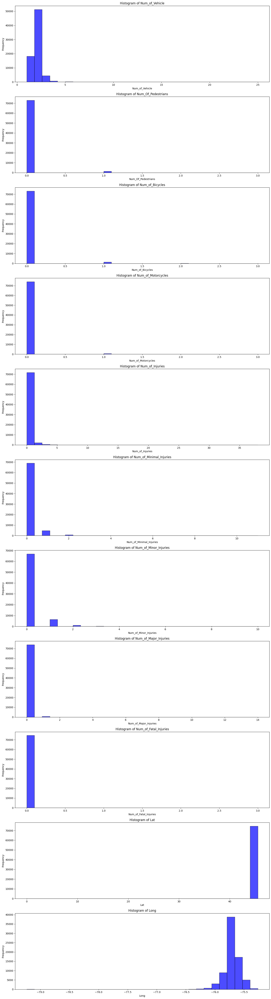

In [14]:
# Step 4: Handle Outliers
# There does not seem to be many outliers

def plot_histograms(df):
    # Get all numerical columns
    numerical_columns = df.select_dtypes(include=['number']).columns

    # Set up the number of plots
    num_cols = len(numerical_columns)
    plt.figure(figsize=(15, 5 * num_cols))

    # Create a histogram for each numerical column
    for i, column in enumerate(numerical_columns):
        plt.subplot(num_cols, 1, i + 1)  # Create a subplot for each histogram
        plt.hist(df[column], bins=30, alpha=0.7, color='blue', edgecolor='black')
        plt.title(f'Histogram of {column}')
        plt.xlabel(column)
        plt.ylabel('Frequency')

    # Adjust layout
    plt.tight_layout()
    plt.show()


plot_histograms(df)



In [16]:
# Step 5: One Hot Encoding

columns_to_encode = [
    'Location_Type', 'Classification_Of_Accident', 'Initial_Impact_Type',
    'Road_Surface_Condition', 'Environment_Condition', 'Light',
    'Traffic_Control', 'Max_Injury'
]

# Ensure the columns to be encoded are treated as strings
for col in columns_to_encode:
    df[col] = df[col].astype(str)

# Perform one-hot encoding
encoded_data = pd.get_dummies(df, columns=columns_to_encode, drop_first=True)

# Display the resulting dataset's shape to confirm encoding
print("Original dataset shape:", df.shape)
print("Encoded dataset shape:", encoded_data.shape)
encoded_data.head(100)

Original dataset shape: (74612, 20)
Encoded dataset shape: (74612, 61)


,Num_of_Vehicle,Num_Of_Pedestrians,Num_of_Bicycles,Num_of_Motorcycles,Num_of_Injuries,Num_of_Minimal_Injuries,Num_of_Minor_Injuries,Num_of_Major_Injuries,Num_of_Fatal_Injuries,Lat,Long,Accident_Timestamp,Location_Type_Midblock,Classification_Of_Accident_Non-fatal injury,Classification_Of_Accident_P.D. only,Initial_Impact_Type_Approaching,Initial_Impact_Type_Other,Initial_Impact_Type_Rear end,Initial_Impact_Type_SMV other,Initial_Impact_Type_SMV unattended vehicle,Initial_Impact_Type_Sideswipe,Initial_Impact_Type_Turning movement,Road_Surface_Condition_Ice,Road_Surface_Condition_Loose sand or gravel,Road_Surface_Condition_Loose snow,Road_Surface_Condition_Mud,Road_Surface_Condition_Other,Road_Surface_Condition_Packed snow,Road_Surface_Condition_Slush,Road_Surface_Condition_Spilled liquid,Road_Surface_Condition_Unknown,Road_Surface_Condition_Wet,Environment_Condition_Drifting Snow,"Environment_Condition_Fog, mist, smoke, dust",Environment_Condition_Freezing Rain,Environment_Condition_Other,Environment_Condition_Rain,Environment_Condition_Snow,Environment_Condition_Strong wind,Environment_Condition_Unknown,Light_Dawn,Light_Daylight,Light_Dusk,Light_Other,Light_Unknown,Traffic_Control_MPS,Traffic_Control_No control,Traffic_Control_Other,Traffic_Control_Ped. crossover,Traffic_Control_Roundabout,Traffic_Control_School bus,Traffic_Control_Stop sign,Traffic_Control_Traffic controller,Traffic_Control_Traffic gate,Traffic_Control_Traffic signal,Traffic_Control_Yield sign,Max_Injury_Fatal,Max_Injury_Major,Max_Injury_Minimal,Max_Injury_Minor,Max_Injury_None
0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.254481,-75.931061,2017-01-01 01:28:00,True,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.428323,-75.663225,2017-01-01 03:16:00,True,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.324735,-75.826700,2017-01-01 07:17:00,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
3,2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.338011,-75.725984,2017-01-01 08:58:00,False,False,True,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
4,2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.383786,-75.671842,2017-01-01 11:41:00,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.370558,-75.718691,2017-01-04 15:21:00,True,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False


# Section 3.   Exploratory Data Analysis
---
1.   Generate the YData Profiling Report



In [ ]:
!pip install ydata-profiling -q

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 34.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 70.4 MB/s eta 0:00:00


In [ ]:
# 1. Generate the YData Profiling Report

from ydata_profiling import ProfileReport
profile = ProfileReport(encoded_data, title="Traffic Collision Report")
profile.to_file("collision_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
# Check for correlation
encoded_data.dtypes

,0
Num_of_Vehicle,int64
Num_Of_Pedestrians,int64
Num_of_Bicycles,float64
Num_of_Motorcycles,float64
Num_of_Injuries,float64
...,...
Max_Injury_Fatal,bool
Max_Injury_Major,bool
Max_Injury_Minimal,bool
Max_Injury_Minor,bool


In [18]:
numeric_df = encoded_data.select_dtypes(include=['number'])
correlation_matrix = numeric_df.corr()
print(correlation_matrix)

                         Num_of_Vehicle  Num_Of_Pedestrians  Num_of_Bicycles  \
Num_of_Vehicle                 1.000000           -0.197843         0.040518   
Num_Of_Pedestrians            -0.197843            1.000000        -0.016299   
Num_of_Bicycles                0.040518           -0.016299         1.000000   
Num_of_Motorcycles            -0.028904           -0.009628        -0.005040   
Num_of_Injuries                0.083866            0.204420         0.153552   
Num_of_Minimal_Injuries        0.080481            0.088416         0.089452   
Num_of_Minor_Injuries          0.055644            0.170062         0.120871   
Num_of_Major_Injuries         -0.016014            0.113138         0.056593   
Num_of_Fatal_Injuries         -0.021386            0.071771         0.012849   
Lat                            0.020550            0.003665        -0.000049   
Long                           0.070478            0.012217         0.003003   

                         Num_of_Motorcy

<Axes: >

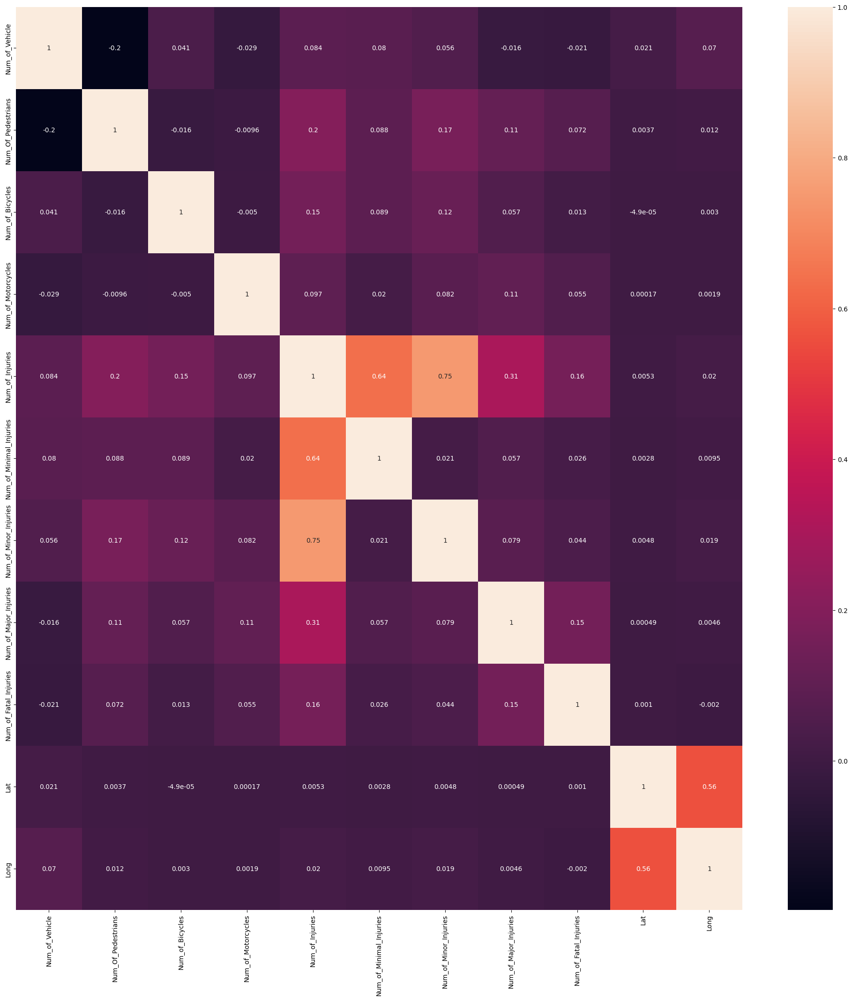

In [20]:
# HeatMap
plt.figure(figsize=(25,25))
sns.heatmap(correlation_matrix, annot=True)



# Section 4. Visualize the hotspots using K Means Clustering
---

Algorithm
*   K-means clustering or DBScan to find high collision areas





In [21]:
pip install pandas folium -q

In [22]:
import pandas as pd
import folium

def create_map(df, lat_column, lon_column, value_column=None):
    m = folium.Map(location=[df[lat_column].mean(), df[lon_column].mean()], zoom_start=12)

    for _, row in df.iterrows():
      if row[value_column] > 0:
        popup_text = f'{value_column}: {row[value_column]}' if value_column else None
        folium.CircleMarker(
            location=(row[lat_column], row[lon_column]),
            radius=1,
            color='red',
            fill=True,
            fill_color='red',
            fill_opacity=0.5,
            popup=popup_text
        ).add_to(m)

    return m

lat_column = 'Lat'
lon_column = 'Long'
value_column = 'Num_of_Injuries'

# Create the map
map_with_dots = create_map(encoded_data, lat_column, lon_column, value_column)

map_with_dots

# Save the map to an HTML file
# map_with_dots.save('map_with_dots.html')

# Section 5. Predictive Analysitcs using Logistic Regression
---

We can use logistic regression or random forest to predicting  the collision percentage at at user input location.

Logistic Regression
*  Binary outcome (e.g. collision or no collision)


# Feature Selection

*  Latitude, Longitude
*  Accident_Year, Accident_Date, Accident_Time
*  Environmental factors, Road_Surface_Condition, Environment_Condition, Light)
*  Traffic-related features (Traffic_Control, Num_of_Vehicle)


# Section 6. Predictive Analytics using Random Forest

---

Feature Engineering
*  target variable
